 # <center> Survey Decomposition: Pseudo Parallel Simulation </center>

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import SimPEG.electromagnetics.time_domain as TDEM
from discretize import MeshIO, TensorMesh, utils
from matplotlib import rcParams
from matplotlib.patches import Rectangle,Circle
from matplotlib.colors import LogNorm
from pymatsolver import Pardiso
from SimPEG import maps

In [2]:
def mesh_global2local(mesh, xy_range, cw, pad_rate, npad):
    """
    A function that converting global mesh into local mesh based on the
    coordinates's range of Tx coil.

    Inputs:
    mesh: a Tensormesh object that describe the global mesh
    xy_range: [x_0, x_1, y_0, y_1], list of the coordinates's range of Tx coil
    cw: [cw_x, cw_y], width of core cells in local mesh
    pad_rate: padding rate of the padding cells in local mesh
    npad: [npad_x, npad_y], number of padding cells in local mesh

    Outputs:
    mesh_local: a Tensormesh object that describe the local mesh
    """

    # number of core cells in local mesh
    rx = (xy_range[1]-xy_range[0])%cw[0]# remainder x
    ry = (xy_range[3]-xy_range[2])%cw[1]# remainder y

    if (rx == 0):
        ncx = (xy_range[1]-xy_range[0])//cw[0]
    else:
        ncx = (xy_range[1]-xy_range[0])//cw[0] + 1

    if (ry == 0):
        ncy = (xy_range[3]-xy_range[2])//cw[1]
    else:
        ncy = (xy_range[3]-xy_range[2])//cw[1] + 1

    # building node_x & node_y for local mesh
    hx = [(cw[0],npad[0],-pad_rate), (cw[0],ncx), (cw[0],npad[0],pad_rate)]
    hy = [(cw[1],npad[1],-pad_rate), (cw[1],ncy), (cw[1],npad[1],pad_rate)]
    mesh_local = TensorMesh([hx, hy], 'CC')

    node_x = mesh_local.vectorNx + (xy_range[0]+xy_range[1])/2

    if (mesh.vectorNx[0]>node_x[0]):
        node_x0 = node_x
        node_xm1 = np.append(node_x[1:], mesh.vectorNx[-1])
    elif (mesh.vectorNx[-1]<node_x[-1]):
        node_x0 = np.append(mesh.vectorNx[0], node_x[:-1])
        node_xm1 = node_x
    elif((mesh.vectorNx[0]==node_x[0]) & (mesh.vectorNx[-1]==node_x[-1])):
        node_x0 = node_x[:-1]
        node_xm1 = node_x[1:]
    else:
        node_x0 = np.append(mesh.vectorNx[0], node_x)
        node_xm1 = np.append(node_x, mesh.vectorNx[-1])
    
    node_y = mesh_local.vectorNy + (xy_range[2]+xy_range[3])/2

    if (mesh.vectorNy[0]>node_y[0]):
        node_y0 = node_y
        node_ym1 = np.append(node_y[1:], mesh.vectorNy[-1])
    elif (mesh.vectorNy[-1]<node_y[-1]):
        node_y0 = np.append(mesh.vectorNy[0], node_y[:-1])
        node_ym1 = node_y
    elif((mesh.vectorNy[0]==node_y[0]) & (mesh.vectorNy[-1]==node_y[-1])):
        node_y0 = node_y[:-1]
        node_ym1 = node_y[1:]
    else:
        node_y0 = np.append(mesh.vectorNy[0], node_y)
        node_ym1 = np.append(node_y, mesh.vectorNy[-1])

    # converting node_x & node_y into hx & hy
    hx = node_xm1 - node_x0
    hy = node_ym1 - node_y0

    # rebuilding mesh_local
    mesh_local = TensorMesh([hx, hy, mesh.hz], x0=[min(mesh.vectorNx[0], node_x[0]), min(mesh.vectorNy[0], node_y[0]), mesh.vectorNz[0]])

    # checking for invalid values
    if ((mesh_local.hx>0).all() & (mesh_local.hy>0).all()):
        return mesh_local
    elif ((mesh_local.hx<=0).any()):
        print("Error: the values of mesh_local.hx containing 0 or negative values")
    elif ((mesh_local.hy<=0).any()):
        print("Error: the values of mesh_local.hy containing 0 or negative values")

In [3]:
def FM(rx_x0, rx_x1, n_rx, tx_x0, tx_x1, tx_y0, tx_y1):

    # creating global mesh
    cw_x, cw_y, cw_z = 20, 25, 20
    ncx, ncy, ncz, npad, pad_rate = 112, 6, 10, 28, 1.3

    hx = [(cw_x,npad,-pad_rate), (cw_x,ncx), (cw_x,npad,pad_rate)]
    hy = [(cw_y,npad,-pad_rate), (cw_y,ncy), (cw_y,npad,pad_rate)]
    hz = [(cw_z,npad,-pad_rate), (cw_z,ncz), (cw_z,npad,pad_rate)]
    mesh = TensorMesh([hx,hy,hz], 'CCC')

    # creating local mesh

    mesh_local = mesh_global2local(mesh, [tx_x0, tx_x1, tx_y0, tx_y1], [cw_x, cw_y], 1.3, [npad, npad])

    print('Global Mesh')
    print(mesh)
    print('Local Mesh')
    print(mesh_local)

    # time channel & diffusion distance
    timechannel = np.array([0.05262,  0.08314,  0.1137 ,  0.1442 ,  0.1747 ,  0.2052 ,
                            0.2504 ,  0.3116 ,  0.3727 ,  0.4482 ,  0.5399 ,  0.6599 ,
                            0.8271 ,  1.0249 ,  1.2672 ,  1.5709 ,  1.9633 ,  2.4785 ,
                            3.1166 ,  3.9047 ,  4.8908 ,  6.1464 ,  7.7398 ,  9.7119 ,
                            12.196 ,  15.348 ,  19.306 ,  24.291  ])*1e-3

    print("minimum diffusion distance: {:1.3e} m".format(1260*np.sqrt(10*timechannel[0])))
    print("maximum diffusion distance: {:1.3e} m".format(1260*np.sqrt(1e5*timechannel[-1])))

    # conductivity model parameters
    sig_air = 1e-8
    sig_con = 1e-1
    sig_res = 1e-5

    # background conductivity
    sigma = np.ones(mesh.nC)*sig_air
    sigma[mesh.gridCC[:,2]<0.] = sig_res

    # conductivity model of global mesh
    sigma[(mesh.gridCC[:,2]<0.)&(mesh.gridCC[:,0]<0.)] = sig_con

    # conductivity model of local mesh
    model_local = utils.volume_average(mesh, mesh_local, sigma)

    # assemble survey
    rx = np.linspace(rx_x0, rx_x1, n_rx)# coordinate value of receiver along x axis
    location_s = np.array([[tx_x1,tx_y0,0],[tx_x1,tx_y1,0],[tx_x0,tx_y1,0],[tx_x0,tx_y0,0],[tx_x1,tx_y0,0]])# source location

    srcList = []# source list
    location_r = np.zeros((len(rx),3))# receiver locations

    for ix in range(len(rx)):
        location_r[ix,:] = np.array([[rx[ix], 0., 0.]])# receiver locations

    rx_z = TDEM.Rx.Point_dbdt(location_r, timechannel, 'z')
    src = TDEM.Src.LineCurrent([rx_z], loc=location_s)
    srcList.append(src)

    # set up for the forward simulation
    timesteps = [(4*1e-6,20),(4**2*1e-6,20),(4**3*1e-6,20),(4**4*1e-6,20),(4**5*1e-6,20)]# timesteps
    prb = TDEM.Problem3D_e(mesh_local, Solver=Pardiso, verbose=True, timeSteps=timesteps, sigmaMap=maps.IdentityMap(mesh_local))
    survey = TDEM.Survey(srcList)
    survey.pair(prb)

    # plot model
    rcParams['font.size'] = 20

    indx = mesh.nCx//2
    indy = mesh.nCy//2
    indz = mesh.nCz//2

    fig, ax = plt.subplots(2,3, figsize = (30, 16))

    clim = [1e-8, 1e-1]

    xlim = [-1200., 1200.]
    ylim = [-1200., 1200.]

    dat1 = mesh.plotSlice(sigma, grid=True, ax=ax[0,0], ind=indz, pcolorOpts={'norm':LogNorm()}, clim=clim)
    dat2 = mesh.plotSlice(sigma, grid=True, ax=ax[0,1], ind=indy, normal='Y', pcolorOpts={'norm':LogNorm()}, clim=clim)
    dat3 = mesh.plotSlice(sigma, grid=True, ax=ax[0,2], ind=indy, normal='X', pcolorOpts={'norm':LogNorm()}, clim=clim)

    ax[0,0].set_xlim(xlim)
    ax[0,0].set_ylim(ylim)
    ax[0,1].set_xlim(xlim)
    ax[0,1].set_ylim(ylim)
    ax[0,2].set_xlim(xlim)
    ax[0,2].set_ylim(ylim)

    plt.tight_layout()

    ax[0,0].set_aspect(1)
    ax[0,1].set_aspect(1)
    ax[0,2].set_aspect(1)

    ax[0,0].set_title("Global model at Z={:1.3f} m".format(mesh.vectorCCz[indz]))
    ax[0,1].set_title("Y= {:1.3f}m".format(mesh.vectorCCy[indy]))
    ax[0,2].set_title("X= {:1.3f}m".format(mesh.vectorCCx[indx]))

    fig.subplots_adjust(right=0.9) 
    l = 0.99
    b = 0.09
    w = 0.025
    h = 0.85
    rect = [l,b,w,h] 
    cbar_ax = fig.add_axes(rect) 
    cb=plt.colorbar(dat3[0],ax = ax[0,0], cax=cbar_ax)
    cb.set_label("$\sigma$ (S/m)")

    # plot local model

    indx = mesh_local.nCx//2
    indy = mesh_local.nCy//2
    indz = mesh_local.nCz//2

    dat4 = mesh_local.plotSlice(model_local, grid=True, ax=ax[1,0], ind=indz, pcolorOpts={'norm':LogNorm()}, clim=clim)
    dat5 = mesh_local.plotSlice(model_local, grid=True, ax=ax[1,1], ind=indy, normal='Y', pcolorOpts={'norm':LogNorm()}, clim=clim)
    dat6 = mesh_local.plotSlice(model_local, grid=True, ax=ax[1,2], ind=indy, normal='X', pcolorOpts={'norm':LogNorm()}, clim=clim)

    ax[1,0].set_xlim(xlim)
    ax[1,0].set_ylim(ylim)
    ax[1,1].set_xlim(xlim)
    ax[1,1].set_ylim(ylim)
    ax[1,2].set_xlim(xlim)
    ax[1,2].set_ylim(ylim)

    plt.tight_layout()

    ax[1,0].set_aspect(1)
    ax[1,1].set_aspect(1)
    ax[1,2].set_aspect(1)

    ax[1,0].set_title("Local model at Z={:1.3f} m".format(mesh.vectorCCz[indz]))
    ax[1,1].set_title("Y= {:1.3f}m".format(mesh.vectorCCy[indy]))
    ax[1,2].set_title("X= {:1.3f}m".format(mesh.vectorCCx[indx]))

    # solve the forward simulation
    fields = prb.fields(model_local)

    dpred = survey.dpred(model_local, f=fields)
    data_pred = -dpred.reshape(rx_z.times.size, rx_z.locs[:,0].size)

    data_obs = np.load('./data/{:1.0f}~{:1.0f}.AVG.npy'.format(rx[0] + 1270, rx[-1] + 1270))
    data_obs = data_obs.reshape(28,n_rx)

    # plot the data vary in space
    rcParams['font.size'] = 8

    fig = plt.figure(figsize=(9,4), dpi=350)
    for it in range(len(timechannel)):
        if (it%3==0):
            plt.semilogy(rx + 1270, np.abs(data_obs[it,:]), 'r.-', lw=0.5, markersize =3.5)
            plt.semilogy(rx + 1270, np.abs(data_pred[it,:]), 'b.-', lw=0.5, markersize =3.5)
            plt.xlabel("Rx location (m)")
            plt.ylabel("Voltage (V/Am$^2$)")
            plt.grid(which="both", alpha=0.2)
    
    plt.legend(['d_obs','d_pred'])

    # plot the data vary in time
    for ix in range(int(len(rx)//3)):
        fig, ax = plt.subplots(1,3,figsize=(14, 4), dpi=350)
        ax[0].loglog(timechannel, np.abs(data_obs[:,ix*3]), 'r.-', lw=1)
        ax[0].loglog(timechannel,np.abs(data_pred[:,ix*3]), 'b.-', lw=1)
        ax[0].set_xlabel("t (s)")
        ax[0].set_ylabel("Voltage (V/Am$^2$)")
        ax[0].grid(which="both", alpha=0.2)
        ax[0].set_title('x={:1.0f}m'.format(rx[ix*3] + 1270))
        ax[0].legend(['d_obs','d_pred'])

        ax[1].loglog(timechannel, np.abs(data_obs[:,ix*3+1]), 'r.-', lw=1)
        ax[1].loglog(timechannel,np.abs(data_pred[:,ix*3+1]), 'b.-', lw=1)
        ax[1].set_xlabel("t (s)")
        ax[1].set_ylabel("Voltage (V/Am$^2$)")
        ax[1].grid(which="both", alpha=0.2)
        ax[1].set_title('x={:1.0f}m'.format(rx[ix*3+1] + 1270))
        ax[1].legend(['d_obs','d_pred'])

        ax[2].loglog(timechannel, np.abs(data_obs[:,ix*3+2]), 'r.-', lw=1)
        ax[2].loglog(timechannel,np.abs(data_pred[:,ix*3+2]), 'b.-', lw=1)
        ax[2].set_xlabel("t (s)")
        ax[2].set_ylabel("Voltage (V/Am$^2$)")
        ax[2].grid(which="both", alpha=0.2)
        ax[2].set_title('x={:1.0f}m'.format(rx[ix*3+2] + 1270))
        ax[2].legend(['d_obs','d_pred'])              

    fig, ax = plt.subplots(1,3,figsize=(14, 4), dpi=350)
    for ix in range(int(len(rx)%3)):
        ax[ix].loglog(timechannel, np.abs(data_obs[:,int(len(rx)+ix-len(rx)%3)]), 'r.-', lw=1)
        ax[ix].loglog(timechannel,np.abs(data_pred[:,int(len(rx)+ix-len(rx)%3)]), 'b.-', lw=1)
        ax[ix].set_xlabel("t (s)")
        ax[ix].set_ylabel("Voltage (V/Am$^2$)")
        ax[ix].grid(which="both", alpha=0.2)
        ax[ix].set_title('x={:1.0f}m'.format(rx[int(len(rx)+ix-len(rx)%3)] + 1270))
        ax[ix].legend(['d_obs','d_pred'])

        

Global Mesh

  TensorMesh: 687,456 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x    168   -135,392.08    135,392.08     20.00 31,005.87    1.30
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


Local Mesh

  TensorMesh: 388,740 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x     95   -135,397.08    135,392.08     20.00 31,005.87   20.88
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


minimum diffusion distance: 2.890e+01 m
maximum diffusion distance: 6.210e+04 m


<ipython-input-3-219a8c16af04>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Calculating Initial fields
Factoring the system matrix for the DC problem
**************************************************
Calculating fields(m)
**************************************************
Factoring...   (dt = 4.000000e-06)
Done
    Solving...   (tInd = 1)
    Done...
    Solving...   (tInd = 2)
    Done...
    Solving...   (tInd = 3)
    Done...
    Solving...   (tInd = 4)
    Done...
    Solving...   (tInd = 5)
    Done...
    Solving...   (tInd = 6)
    Done...
    Solving...   (tInd = 7)
    Done...
    Solving...   (tInd = 8)
    Done...
    Solving...   (tInd = 9)
    Done...
    Solving...   (tInd = 10)
    Done...
    Solving...   (tInd = 11)
    Done...
    Solving...   (tInd = 12)
    Done...
    Solving...   (tInd = 13)
    Done...
    Solving...   (tInd = 14)
    Done...
    Solving...   (tInd = 15)
    Done...
    Solving...   (tInd = 16)
    Done...
    Solving...   (tInd = 17)
    Done...
    Solving...   (tInd = 18)
    Done...
    Solving...   (tInd = 19)
    

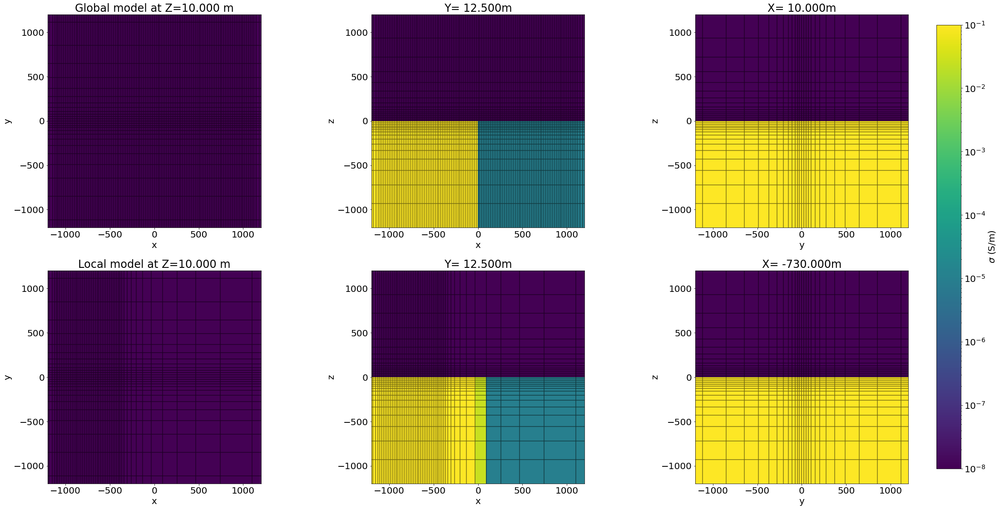

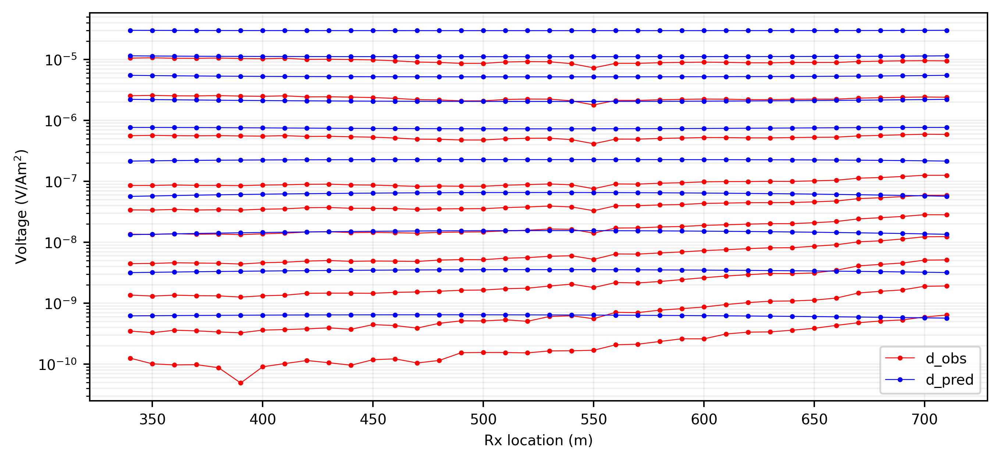

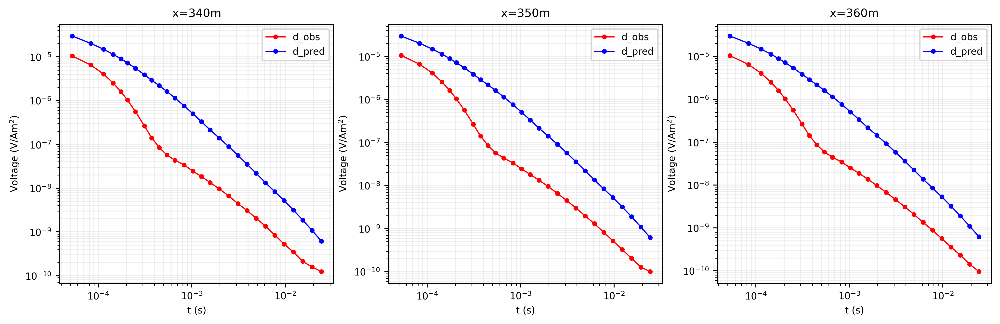

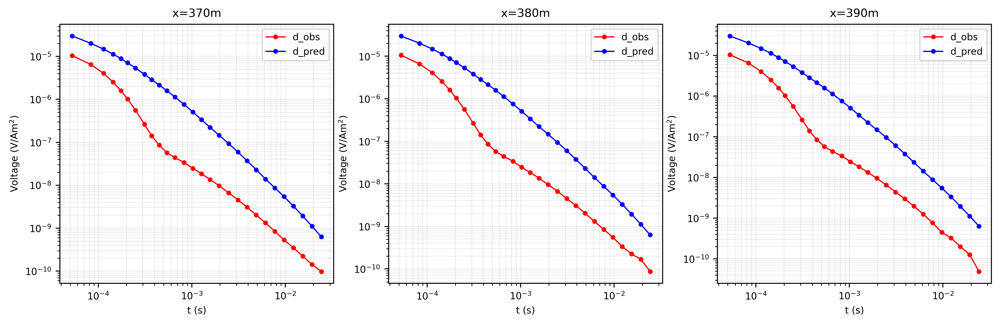

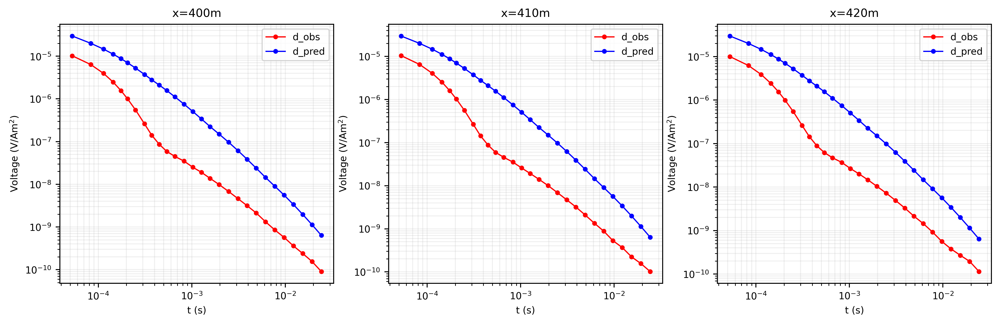

...

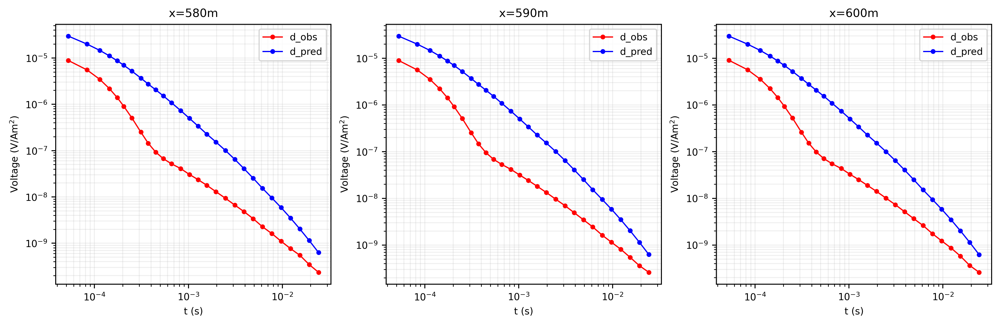

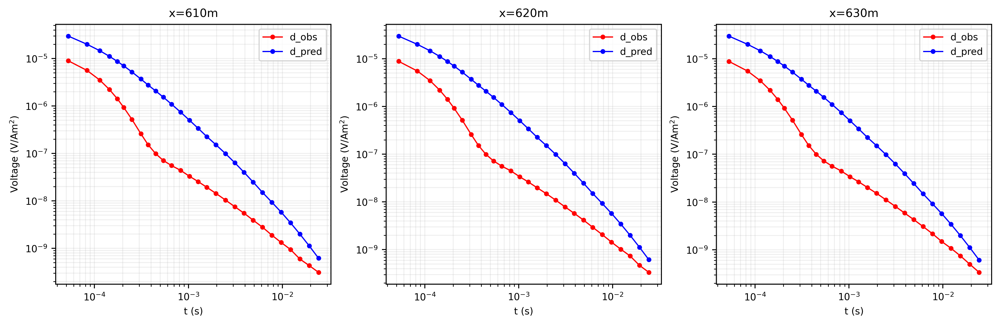

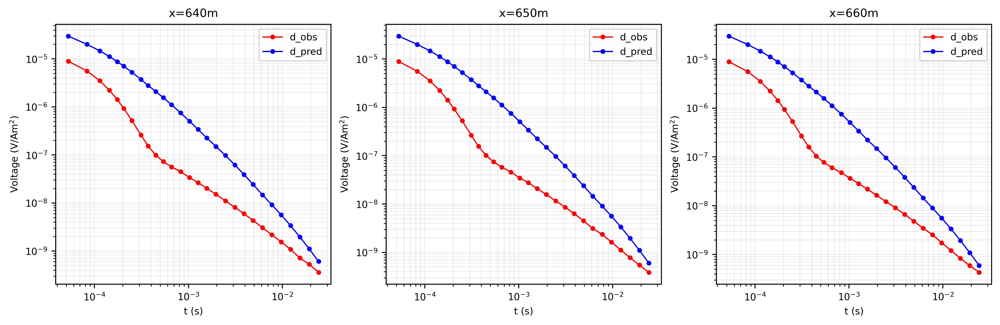

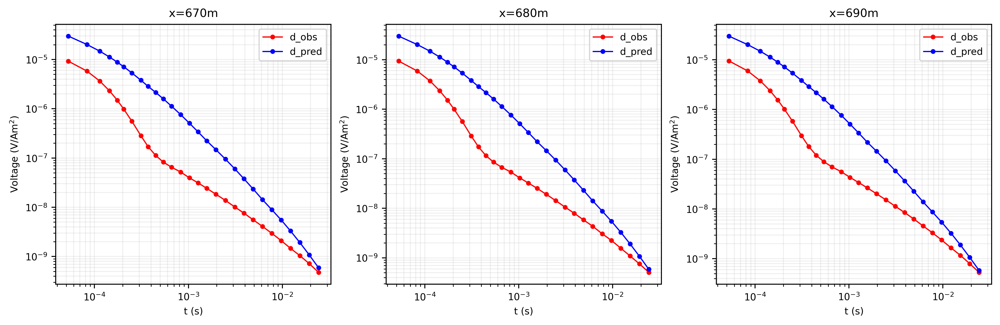

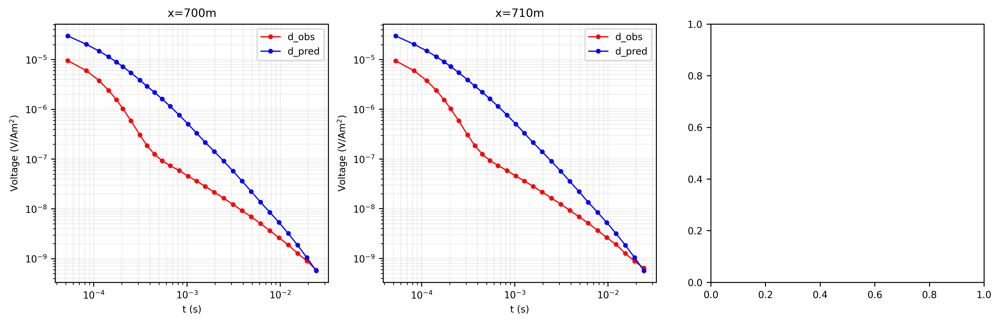

In [4]:
%%time
rx_x0, rx_x1 =340, 710# reciever location
n_rx = int((rx_x1 - rx_x0)/10 + 1)# number of recievers
tx_x0, tx_x1, tx_y0, tx_y1 = 150, 900, -75, 75# source location

FM(rx_x0-1270, rx_x1-1270, n_rx, tx_x0-1270, tx_x1-1270, tx_y0, tx_y1)

Global Mesh

  TensorMesh: 687,456 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x    168   -135,392.08    135,392.08     20.00 31,005.87    1.30
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


Local Mesh

  TensorMesh: 392,832 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x     96   -135,392.08    135,392.08     20.00 31,005.87   84.95
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


minimum diffusion distance: 2.890e+01 m
maximum diffusion distance: 6.210e+04 m


<ipython-input-3-219a8c16af04>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Calculating Initial fields
Factoring the system matrix for the DC problem
**************************************************
Calculating fields(m)
**************************************************
Factoring...   (dt = 4.000000e-06)
Done
    Solving...   (tInd = 1)
    Done...
    Solving...   (tInd = 2)
    Done...
    Solving...   (tInd = 3)
    Done...
    Solving...   (tInd = 4)
    Done...
    Solving...   (tInd = 5)
    Done...
    Solving...   (tInd = 6)
    Done...
    Solving...   (tInd = 7)
    Done...
    Solving...   (tInd = 8)
    Done...
    Solving...   (tInd = 9)
    Done...
    Solving...   (tInd = 10)
    Done...
    Solving...   (tInd = 11)
    Done...
    Solving...   (tInd = 12)
    Done...
    Solving...   (tInd = 13)
    Done...
    Solving...   (tInd = 14)
    Done...
    Solving...   (tInd = 15)
    Done...
    Solving...   (tInd = 16)
    Done...
    Solving...   (tInd = 17)
    Done...
    Solving...   (tInd = 18)
    Done...
    Solving...   (tInd = 19)
    

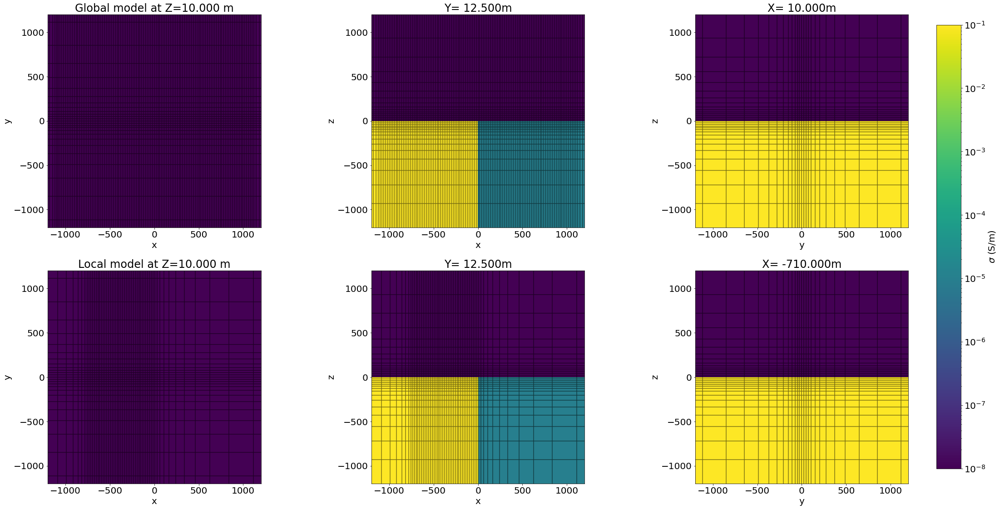

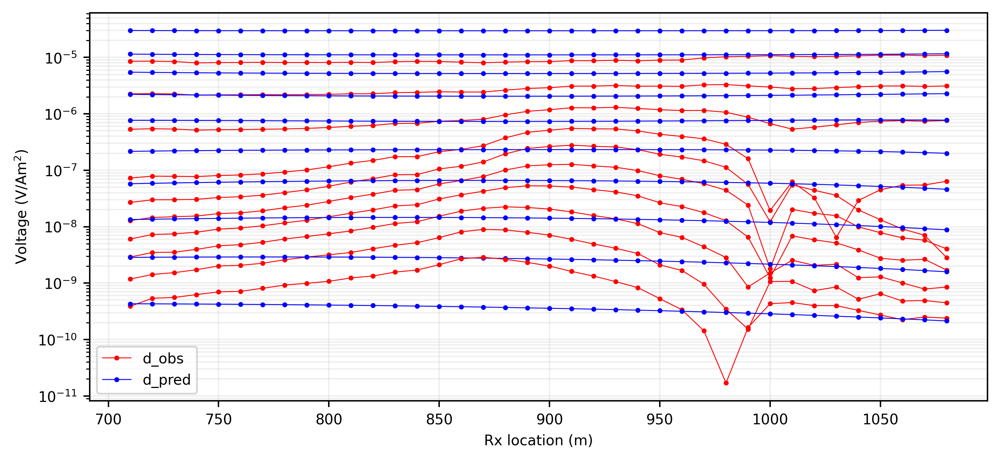

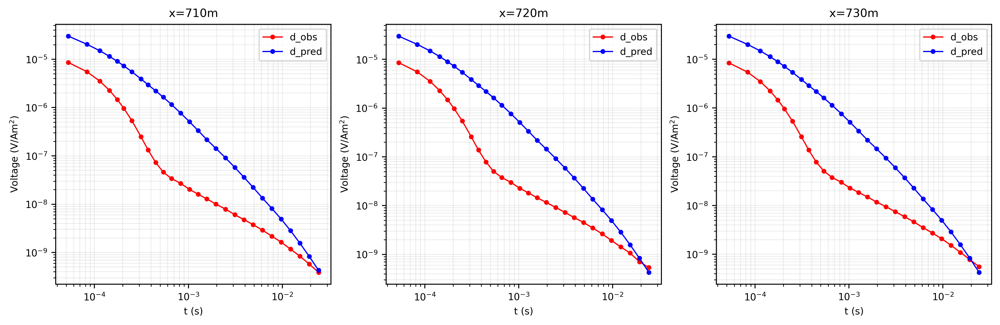

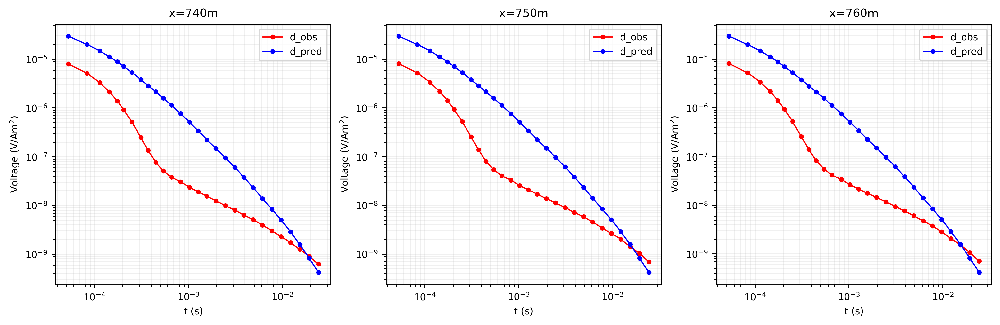

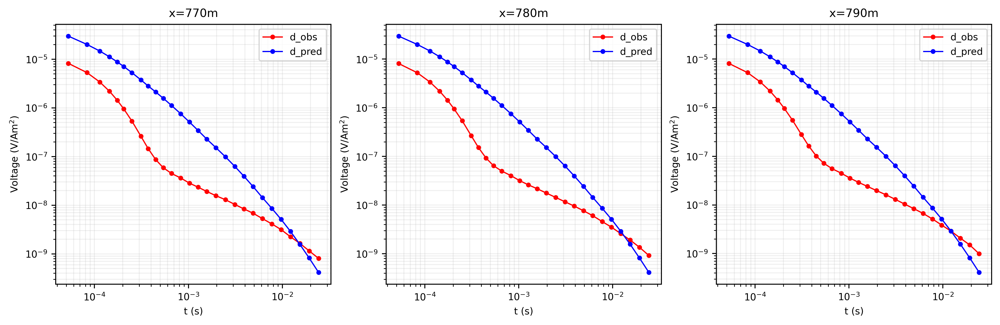

...

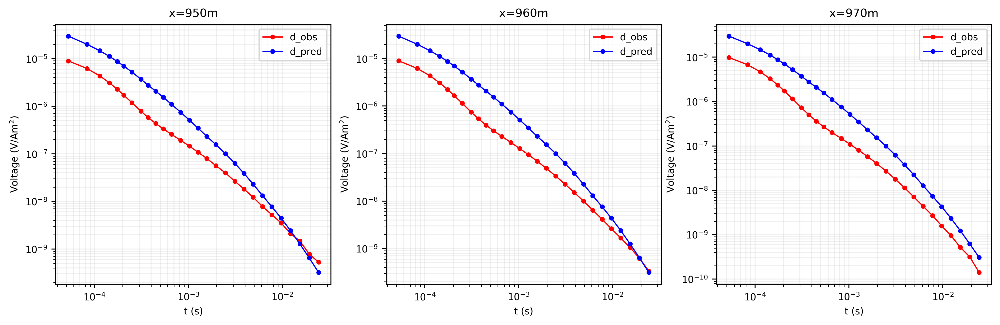

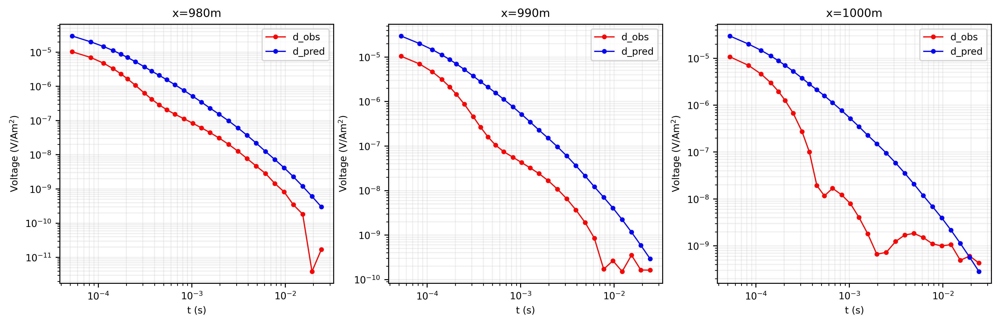

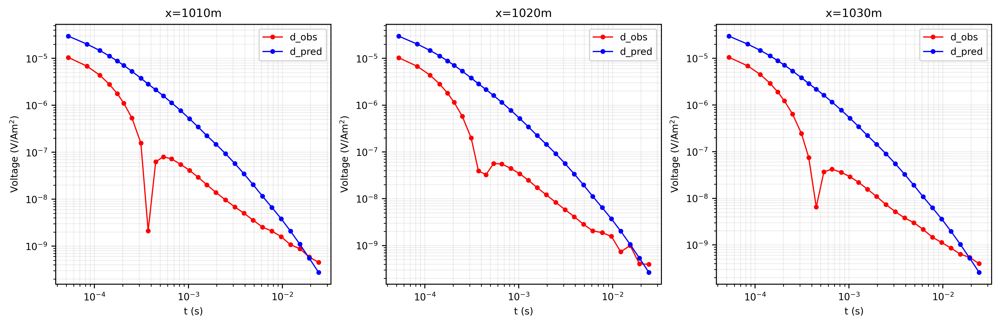

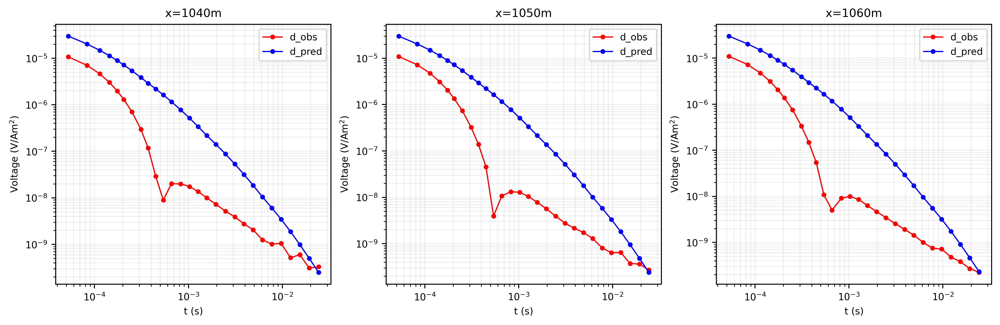

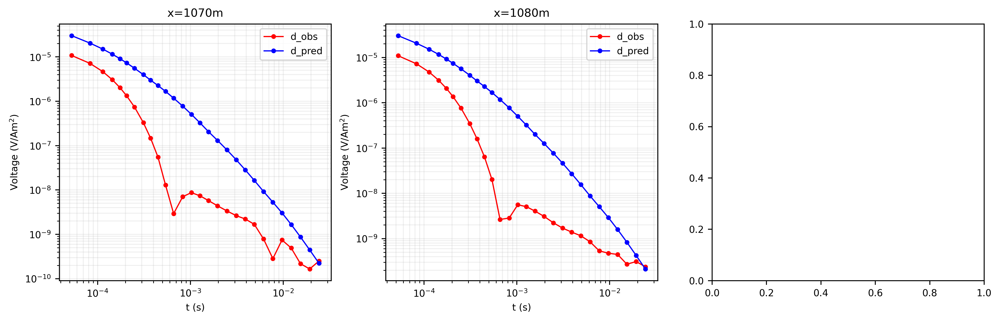

In [7]:
%%time
rx_x0, rx_x1 =710, 1080# reciever location
n_rx = int((rx_x1 - rx_x0)/10 + 1)# number of recievers
tx_x0, tx_x1, tx_y0, tx_y1 = 520, 1270, -75, 75# source location

FM(rx_x0-1270, rx_x1-1270, n_rx, tx_x0-1270, tx_x1-1270, tx_y0, tx_y1)

Global Mesh

  TensorMesh: 687,456 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x    168   -135,392.08    135,392.08     20.00 31,005.87    1.30
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


Local Mesh

  TensorMesh: 392,832 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x     96   -135,392.08    135,392.08     20.00 31,005.87   51.25
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


minimum diffusion distance: 2.890e+01 m
maximum diffusion distance: 6.210e+04 m


<ipython-input-3-219a8c16af04>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Calculating Initial fields
Factoring the system matrix for the DC problem
**************************************************
Calculating fields(m)
**************************************************
Factoring...   (dt = 4.000000e-06)
Done
    Solving...   (tInd = 1)
    Done...
    Solving...   (tInd = 2)
    Done...
    Solving...   (tInd = 3)
    Done...
    Solving...   (tInd = 4)
    Done...
    Solving...   (tInd = 5)
    Done...
    Solving...   (tInd = 6)
    Done...
    Solving...   (tInd = 7)
    Done...
    Solving...   (tInd = 8)
    Done...
    Solving...   (tInd = 9)
    Done...
    Solving...   (tInd = 10)
    Done...
    Solving...   (tInd = 11)
    Done...
    Solving...   (tInd = 12)
    Done...
    Solving...   (tInd = 13)
    Done...
    Solving...   (tInd = 14)
    Done...
    Solving...   (tInd = 15)
    Done...
    Solving...   (tInd = 16)
    Done...
    Solving...   (tInd = 17)
    Done...
    Solving...   (tInd = 18)
    Done...
    Solving...   (tInd = 19)
    

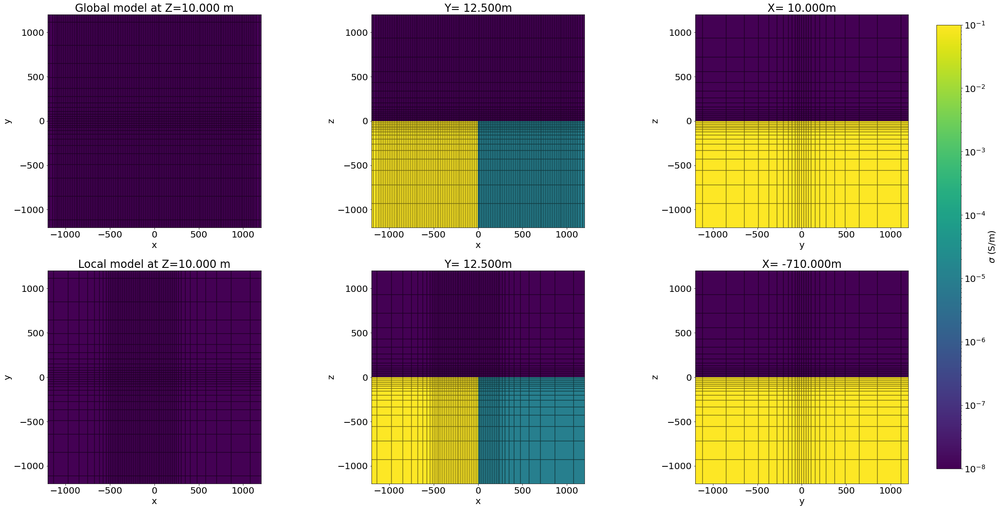

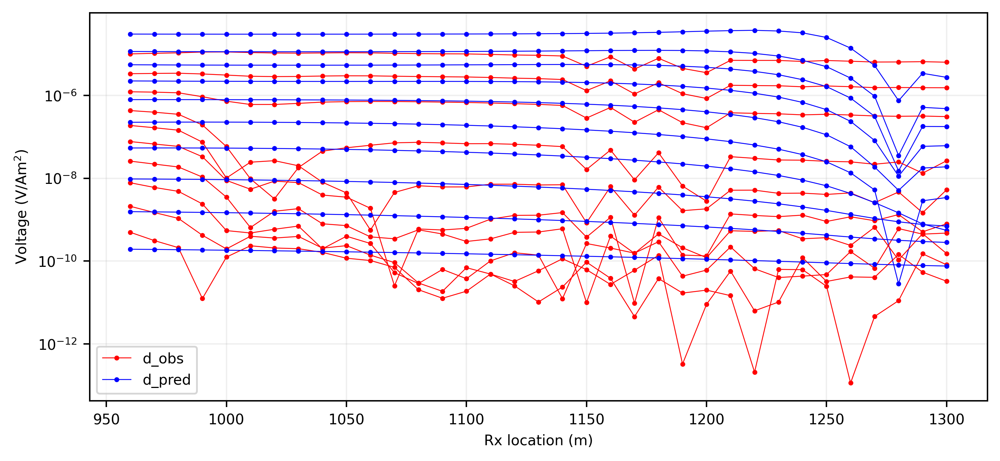

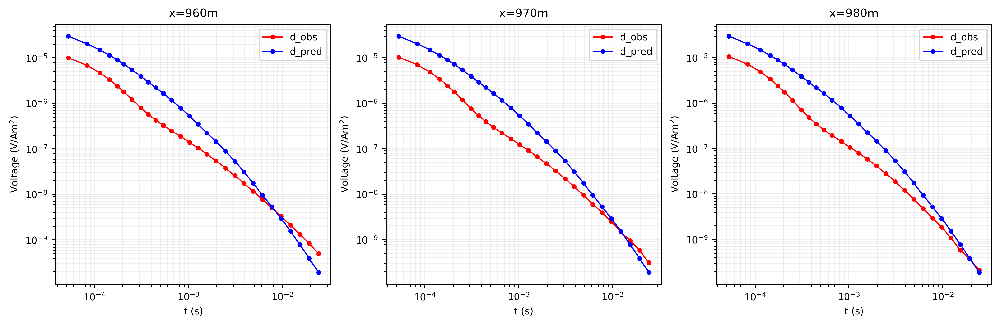

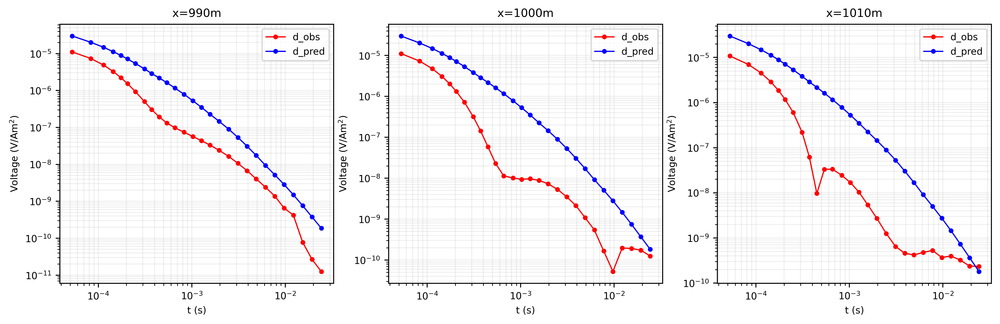

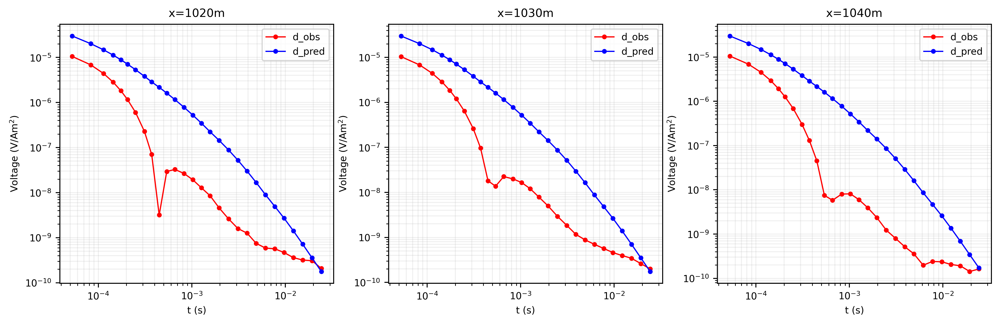

...

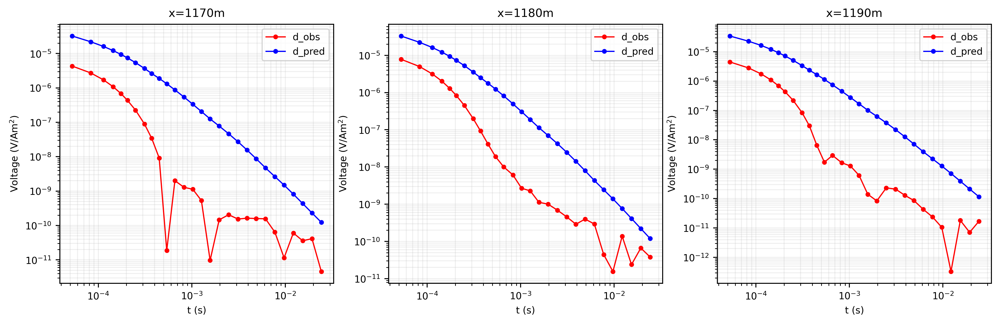

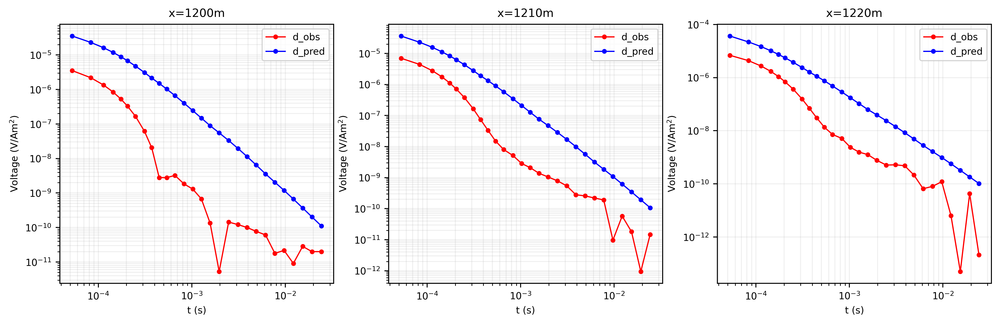

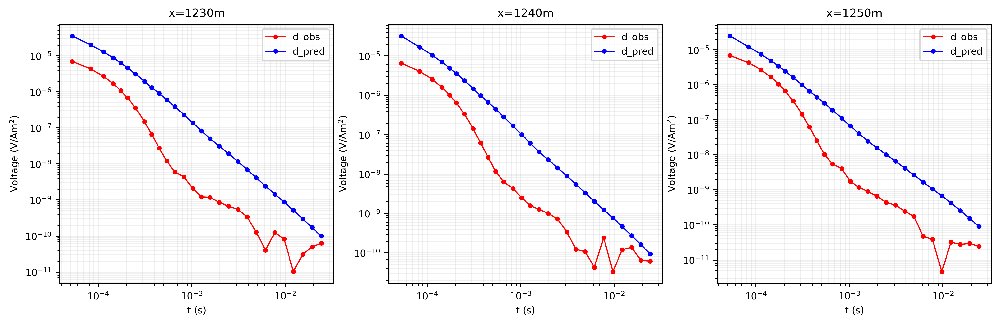

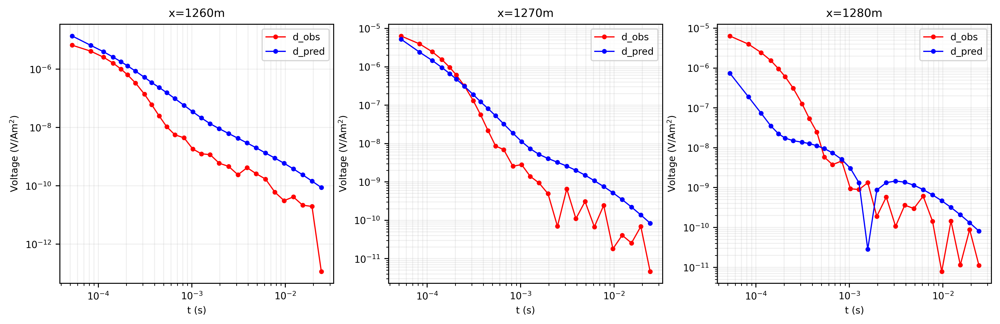

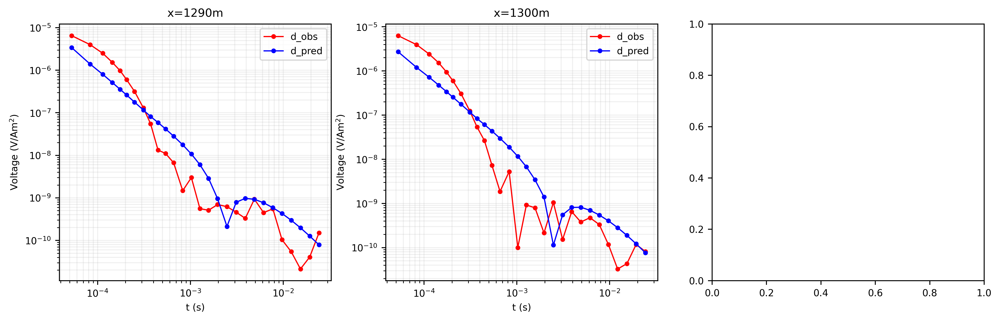

In [6]:
%%time
rx_x0, rx_x1 =960, 1300# reciever location
n_rx = int((rx_x1 - rx_x0)/10 + 1)# number of recievers
tx_x0, tx_x1, tx_y0, tx_y1 = 760, 1510, -75, 75# source location

FM(rx_x0-1270, rx_x1-1270, n_rx, tx_x0-1270, tx_x1-1270, tx_y0, tx_y1)

Global Mesh

  TensorMesh: 687,456 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x    168   -135,392.08    135,392.08     20.00 31,005.87    1.30
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


Local Mesh

  TensorMesh: 392,832 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x     96   -135,392.08    135,392.08     20.00 31,005.87   52.11
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


minimum diffusion distance: 2.890e+01 m
maximum diffusion distance: 6.210e+04 m


<ipython-input-3-219a8c16af04>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Calculating Initial fields
Factoring the system matrix for the DC problem
**************************************************
Calculating fields(m)
**************************************************
Factoring...   (dt = 4.000000e-06)
Done
    Solving...   (tInd = 1)
    Done...
    Solving...   (tInd = 2)
    Done...
    Solving...   (tInd = 3)
    Done...
    Solving...   (tInd = 4)
    Done...
    Solving...   (tInd = 5)
    Done...
    Solving...   (tInd = 6)
    Done...
    Solving...   (tInd = 7)
    Done...
    Solving...   (tInd = 8)
    Done...
    Solving...   (tInd = 9)
    Done...
    Solving...   (tInd = 10)
    Done...
    Solving...   (tInd = 11)
    Done...
    Solving...   (tInd = 12)
    Done...
    Solving...   (tInd = 13)
    Done...
    Solving...   (tInd = 14)
    Done...
    Solving...   (tInd = 15)
    Done...
    Solving...   (tInd = 16)
    Done...
    Solving...   (tInd = 17)
    Done...
    Solving...   (tInd = 18)
    Done...
    Solving...   (tInd = 19)
    

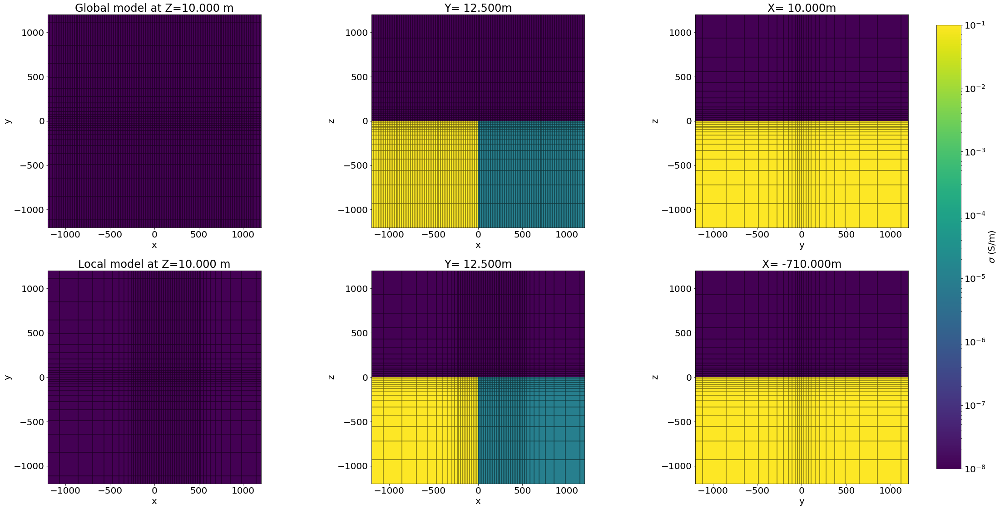

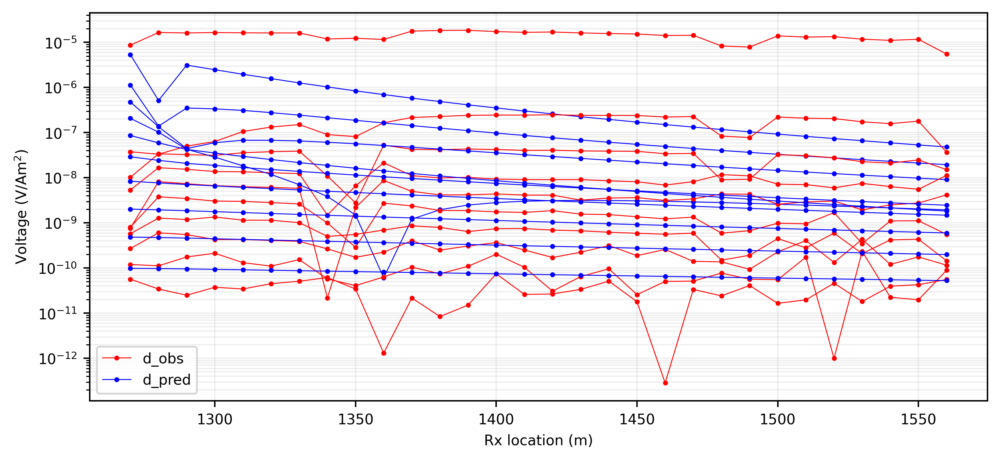

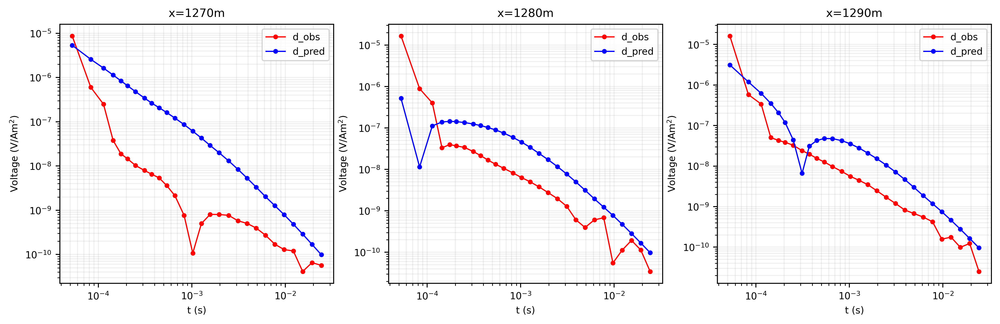

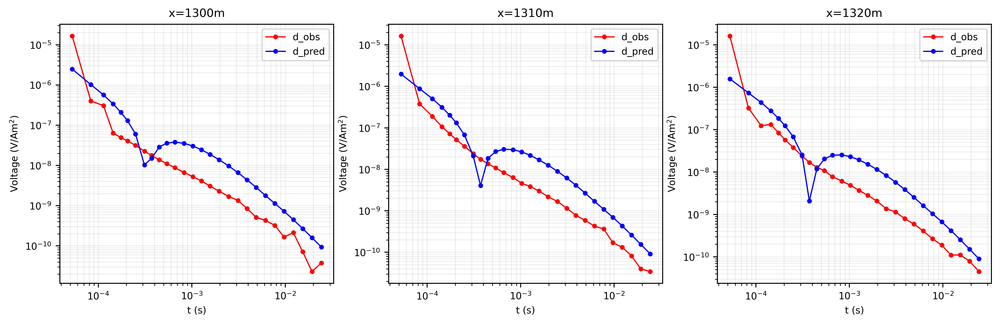

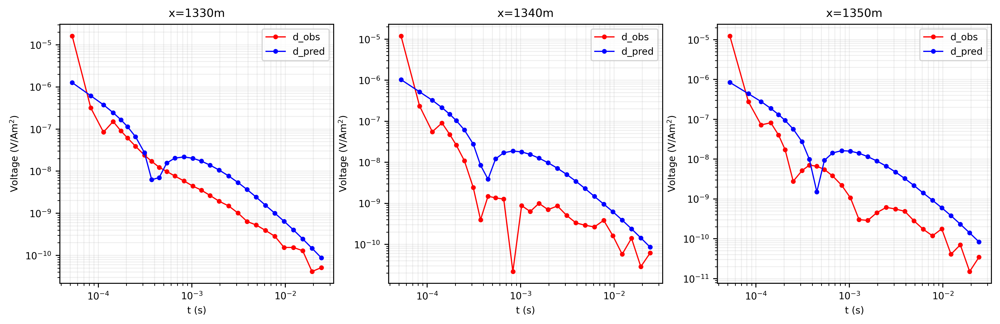

...

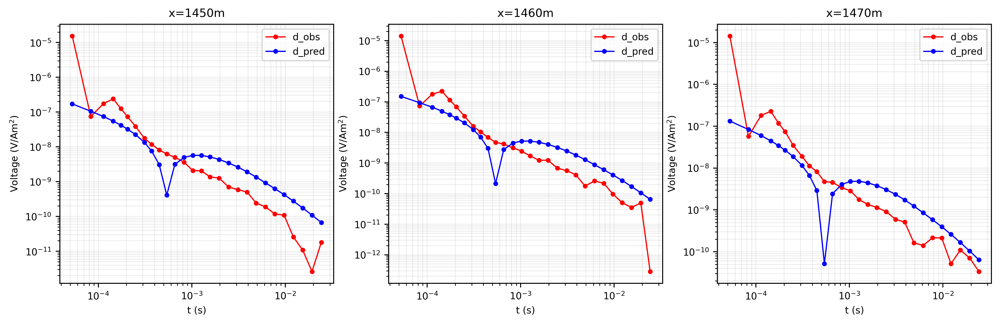

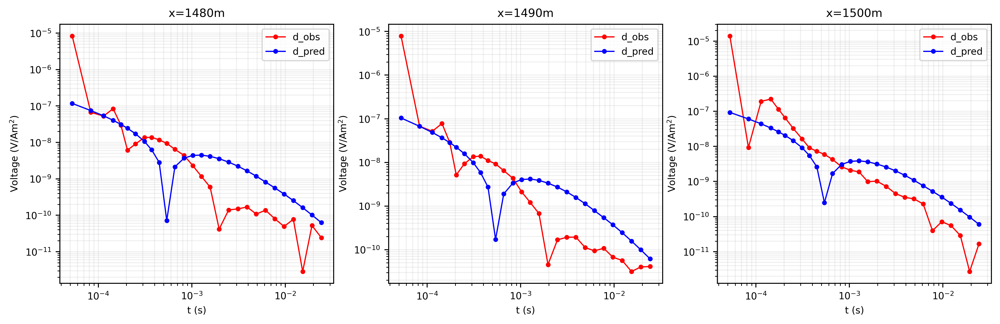

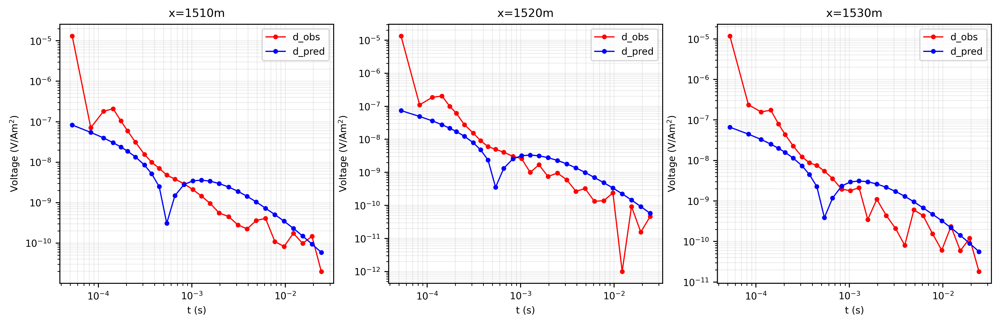

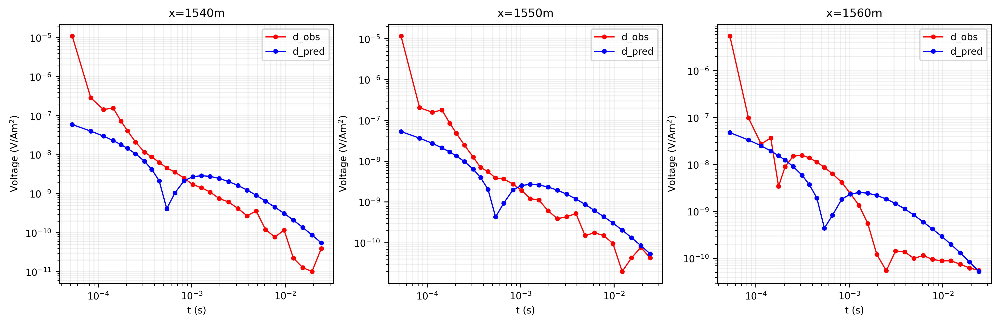

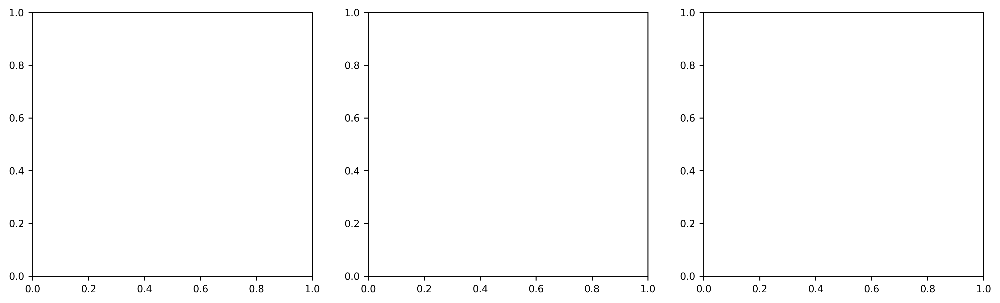

In [7]:
%%time
rx_x0, rx_x1 =1270, 1560# reciever location
n_rx = int((rx_x1 - rx_x0)/10 + 1)# number of recievers
tx_x0, tx_x1, tx_y0, tx_y1 = 1040, 1790, -75, 75# source location

FM(rx_x0-1270, rx_x1-1270, n_rx, tx_x0-1270, tx_x1-1270, tx_y0, tx_y1)

Global Mesh

  TensorMesh: 687,456 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x    168   -135,392.08    135,392.08     20.00 31,005.87    1.30
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


Local Mesh

  TensorMesh: 392,832 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x     96   -135,392.08    135,392.08     20.00 31,005.87  101.66
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


minimum diffusion distance: 2.890e+01 m
maximum diffusion distance: 6.210e+04 m


<ipython-input-3-219a8c16af04>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Calculating Initial fields
Factoring the system matrix for the DC problem
**************************************************
Calculating fields(m)
**************************************************
Factoring...   (dt = 4.000000e-06)
Done
    Solving...   (tInd = 1)
    Done...
    Solving...   (tInd = 2)
    Done...
    Solving...   (tInd = 3)
    Done...
    Solving...   (tInd = 4)
    Done...
    Solving...   (tInd = 5)
    Done...
    Solving...   (tInd = 6)
    Done...
    Solving...   (tInd = 7)
    Done...
    Solving...   (tInd = 8)
    Done...
    Solving...   (tInd = 9)
    Done...
    Solving...   (tInd = 10)
    Done...
    Solving...   (tInd = 11)
    Done...
    Solving...   (tInd = 12)
    Done...
    Solving...   (tInd = 13)
    Done...
    Solving...   (tInd = 14)
    Done...
    Solving...   (tInd = 15)
    Done...
    Solving...   (tInd = 16)
    Done...
    Solving...   (tInd = 17)
    Done...
    Solving...   (tInd = 18)
    Done...
    Solving...   (tInd = 19)
    

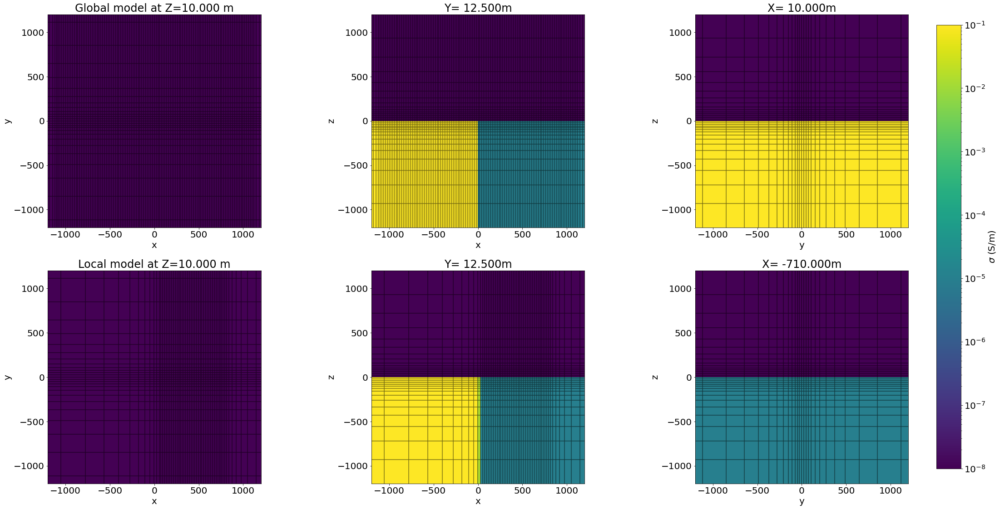

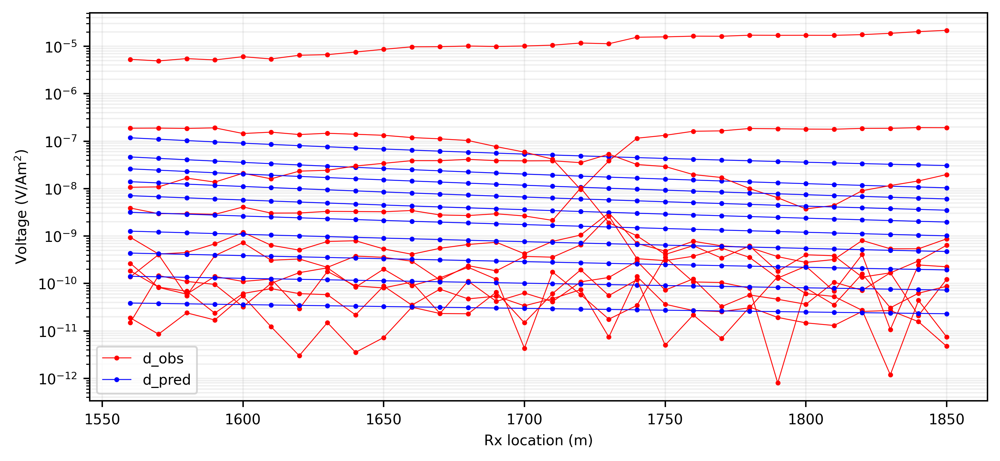

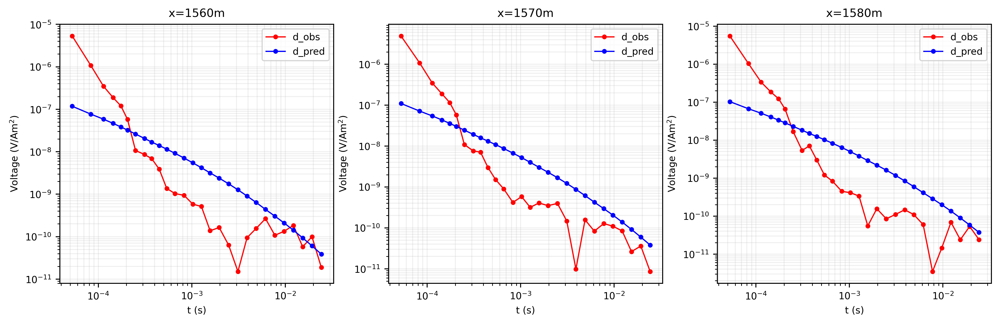

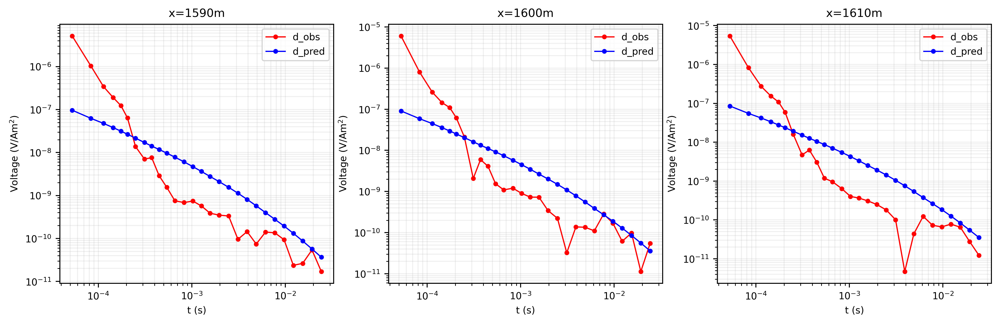

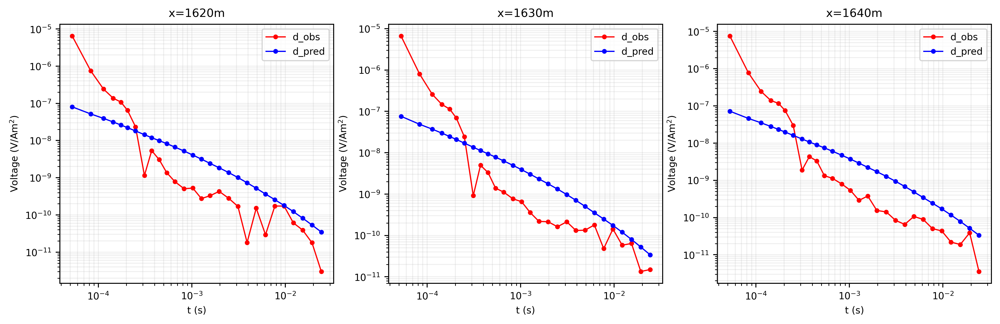

...

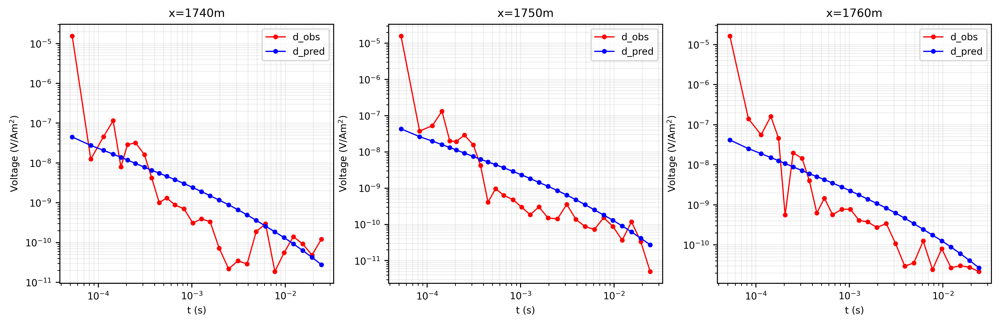

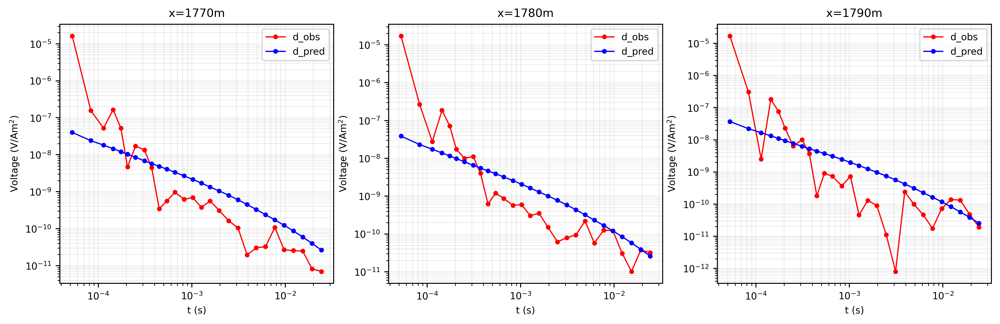

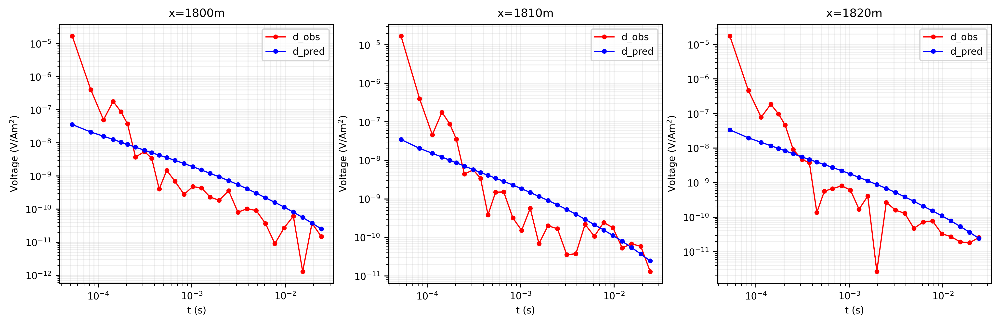

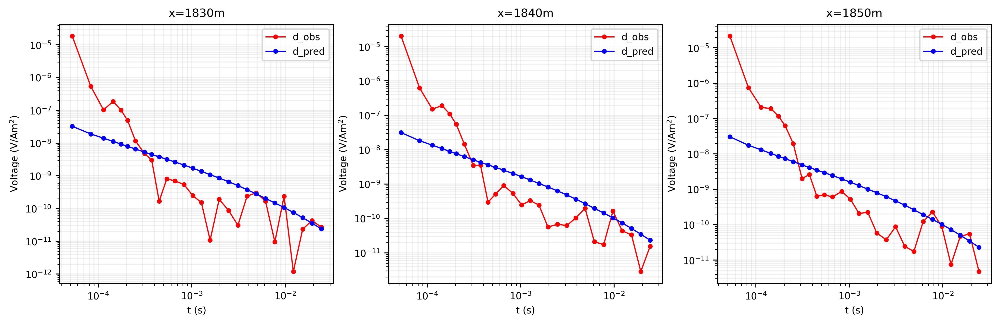

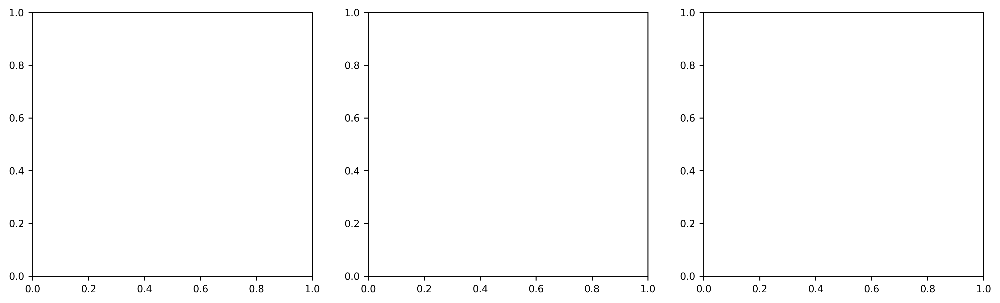

In [6]:
%%time
rx_x0, rx_x1 =1560, 1850# reciever location
n_rx = int((rx_x1 - rx_x0)/10 + 1)# number of recievers
tx_x0, tx_x1, tx_y0, tx_y1 = 1330, 2080, -75, 75# source location

FM(rx_x0-1270, rx_x1-1270, n_rx, tx_x0-1270, tx_x1-1270, tx_y0, tx_y1)

In [ ]:
%%time
rx_x0, rx_x1 =1850, 2160# reciever location
n_rx = int((rx_x1 - rx_x0)/10 + 1)# number of recievers
tx_x0, tx_x1, tx_y0, tx_y1 = 1630, 2380, -75, 75# source location

FM(rx_x0-1270, rx_x1-1270, n_rx, tx_x0-1270, tx_x1-1270, tx_y0, tx_y1)

Global Mesh

  TensorMesh: 687,456 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x    168   -135,392.08    135,392.08     20.00 31,005.87    1.30
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


Local Mesh

  TensorMesh: 392,832 cells

                      MESH EXTENT             CELL WIDTH      FACTOR
  dir    nC        min           max         min       max      max
  ---   ---  ---------------------------  ------------------  ------
   x     96   -135,392.08    135,392.08      5.00 31,005.876,201.17
   y     62   -167,915.11    167,915.11     25.00 38,757.33    1.30
   z     66   -134,372.08    134,372.08     20.00 31,005.87    1.30


minimum diffusion distance: 2.890e+01 m
maximum diffusion distance: 6.210e+04 m


<ipython-input-3-219a8c16af04>:128: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Calculating Initial fields
Factoring the system matrix for the DC problem
